In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering

In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import scipy.io
import matplotlib.pyplot as plt
import os
import anndata
import harmonypy as hm
import seaborn as sns
import scrublet as scr
import bbknn as bk
%matplotlib inline

/rds/general/user/snb20/home/anaconda3/envs/scanpy1.8.2/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
sc.settings.set_figure_params(dpi=250,fontsize=10)

In [4]:
adata = sc.read_h5ad("/rds/general/user/snb20/home/2_Organotypic_EC_Heterogeneity/Sanger_Datasets/Resolve/Test/Test2_nolog/bin50_A2-1.h5ad")

In [5]:
adata

AnnData object with n_obs × n_vars = 80252 × 99
    obs: 'X_Y_bins', 'X_coor', 'Y_coor'
    var: 'Genes'
    uns: 'spatial'
    obsm: 'spatial'

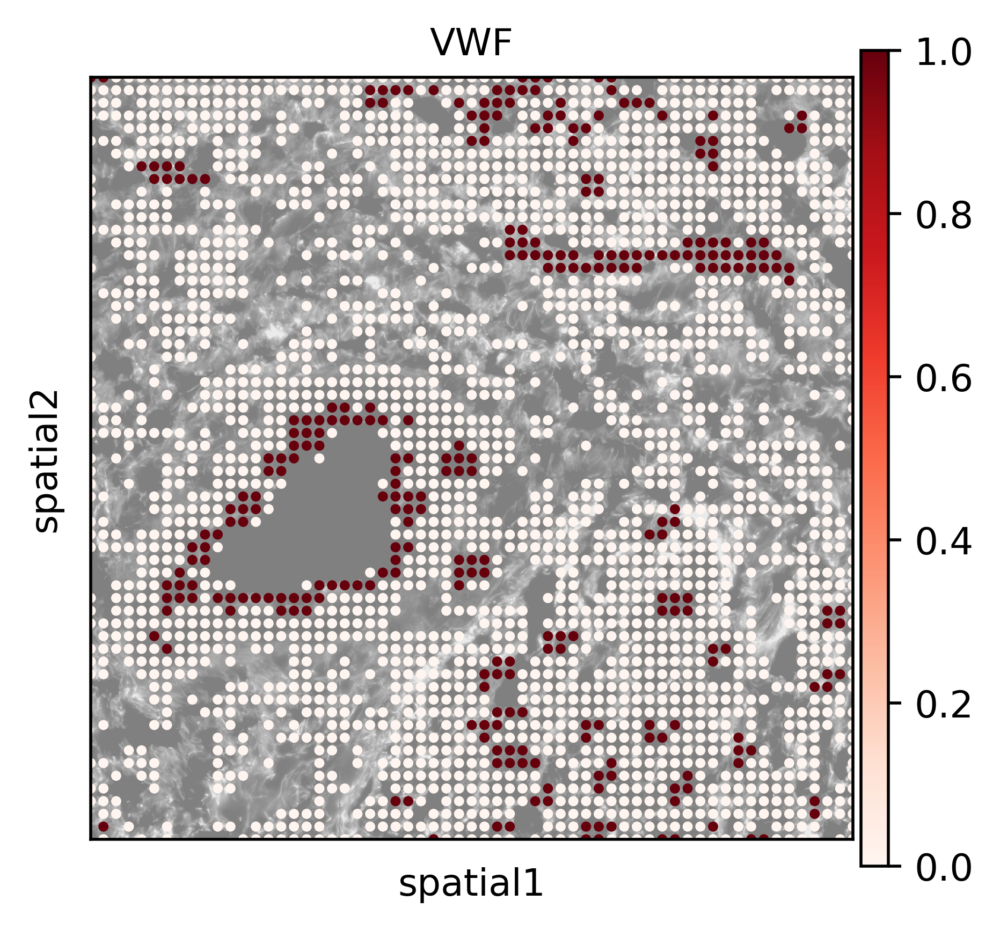

In [25]:
sc.pl.spatial(adata,
              color="VWF",img_key='WGA',size=8, alpha_img = 0.5, cmap = 'Reds', vmax = 1, crop_coord = [24750,27750,7000,10000])

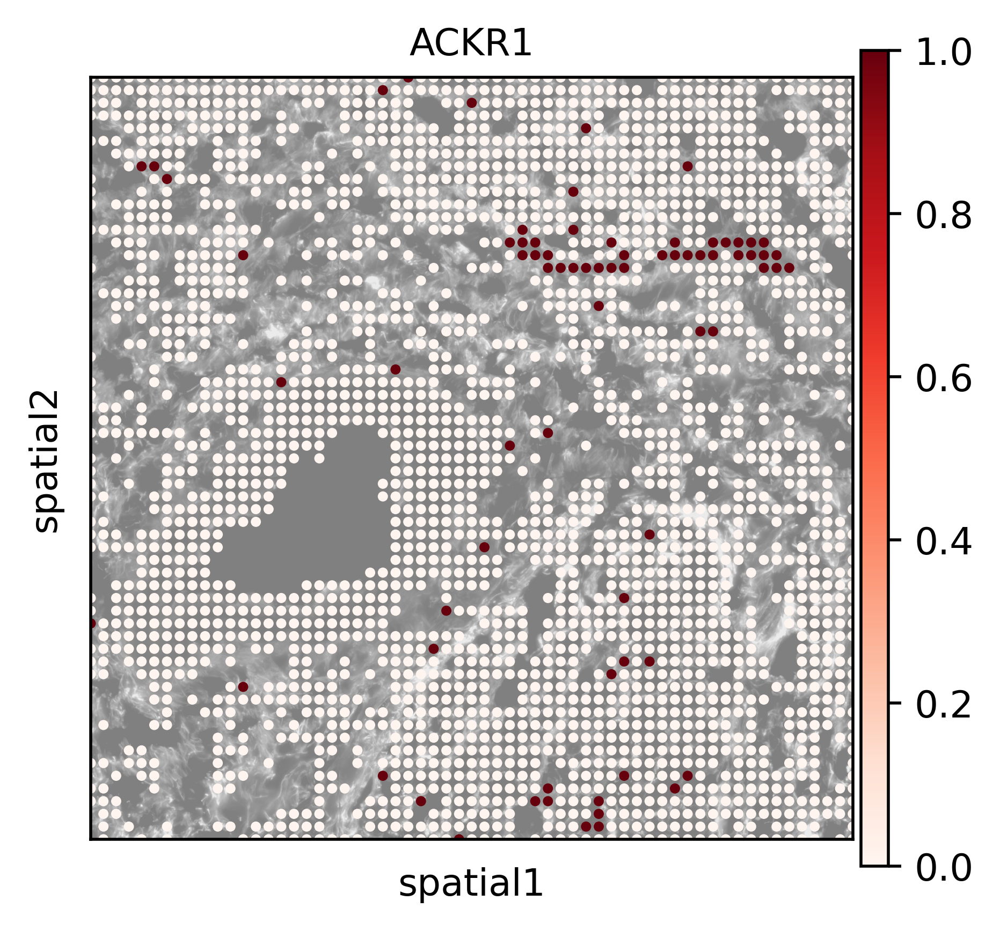

In [26]:
sc.pl.spatial(adata,
              color="ACKR1",img_key='WGA',size=8, alpha_img = 0.5, cmap = 'Reds', vmax = 1, crop_coord = [24750,27750,7000,10000])

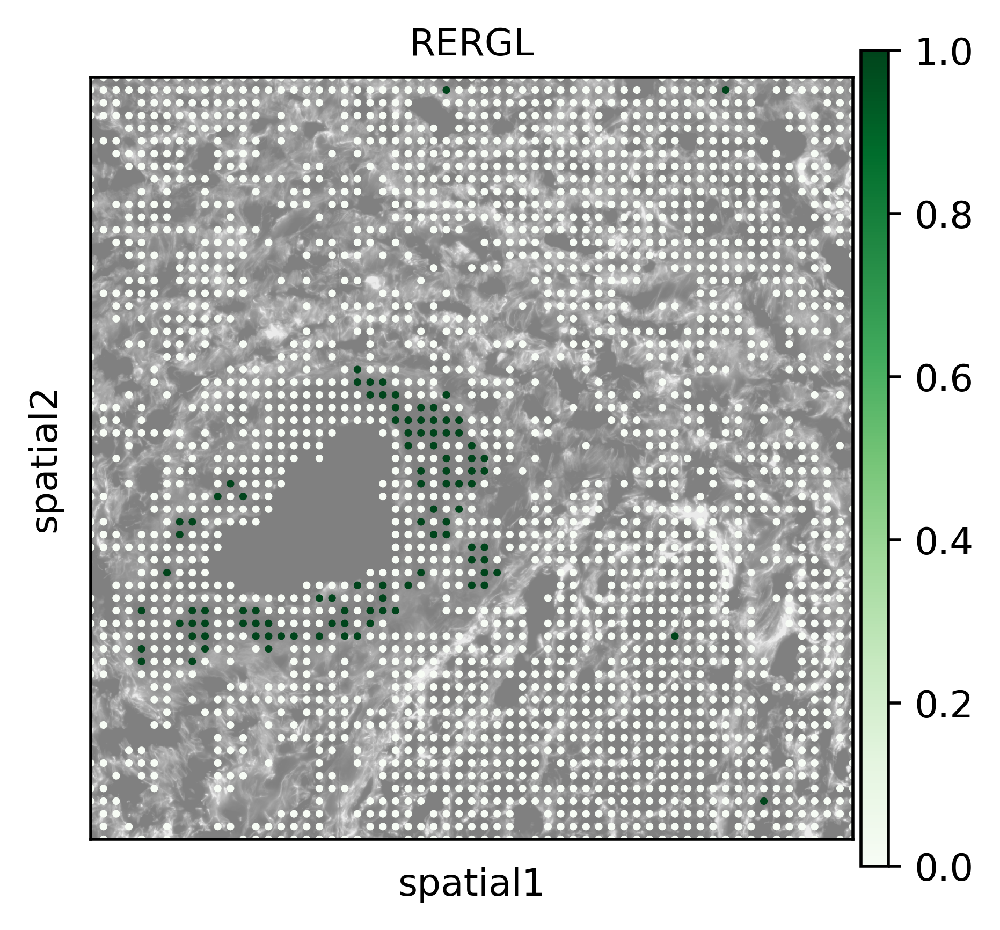

In [35]:
sc.pl.spatial(adata,
              color="RERGL",img_key='WGA',size=6, alpha_img = 0.5, cmap = 'Greens', vmax = 1, crop_coord = [24750,27750,7000,10000])

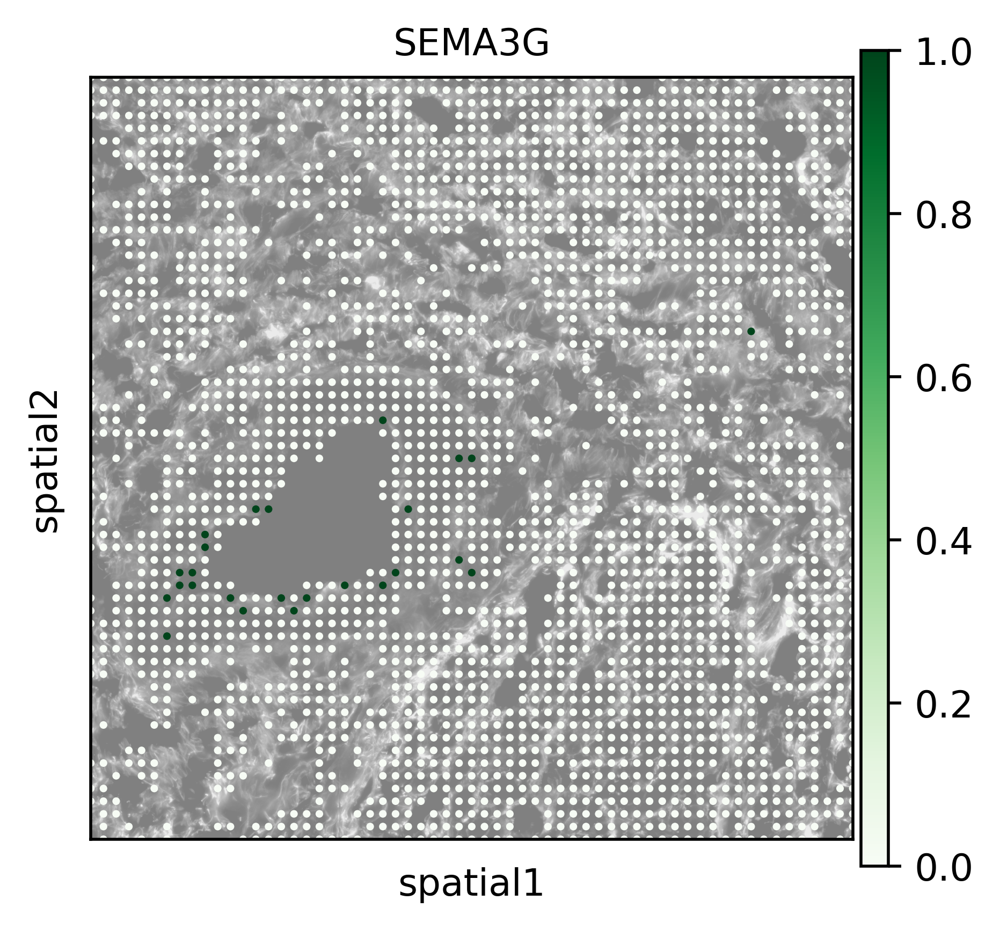

In [38]:
sc.pl.spatial(adata,
              color="SEMA3G",img_key='WGA',size=6, alpha_img = 0.5, cmap = 'Greens', vmax = 1, crop_coord = [24750,27750,7000,10000])

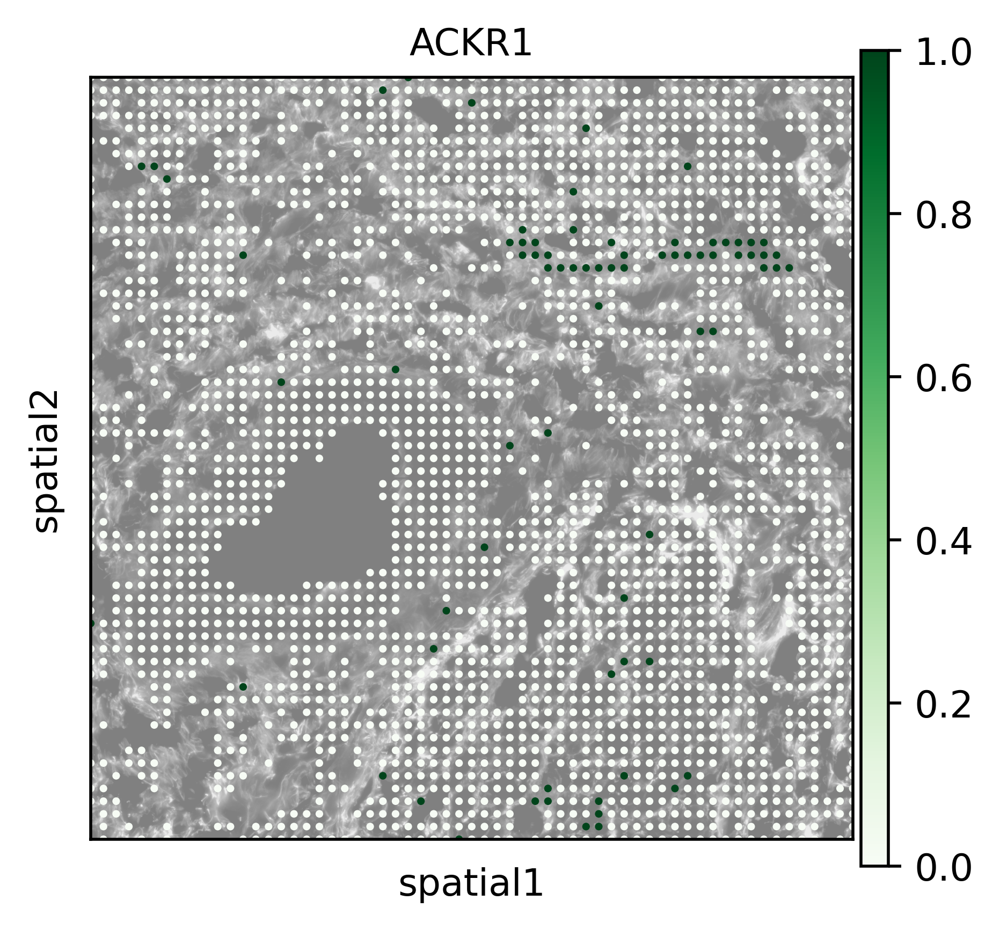

In [36]:
sc.pl.spatial(adata,
              color="ACKR1",img_key='WGA',size=6, alpha_img = 0.5, cmap = 'Greens', vmax = 1, crop_coord = [24750,27750,7000,10000])

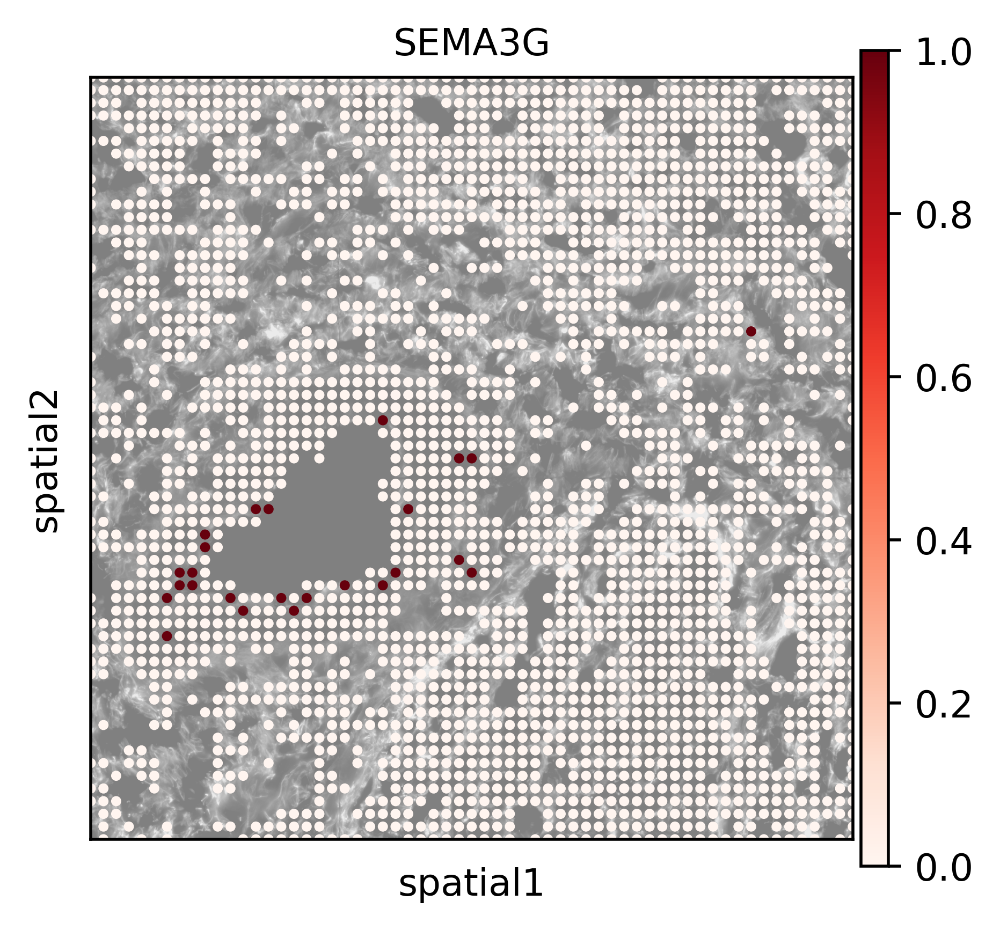

In [28]:
sc.pl.spatial(adata,
              color="SEMA3G",img_key='WGA',size=8, alpha_img = 0.5, cmap = 'Reds', vmax = 1, crop_coord = [24750,27750,7000,10000])

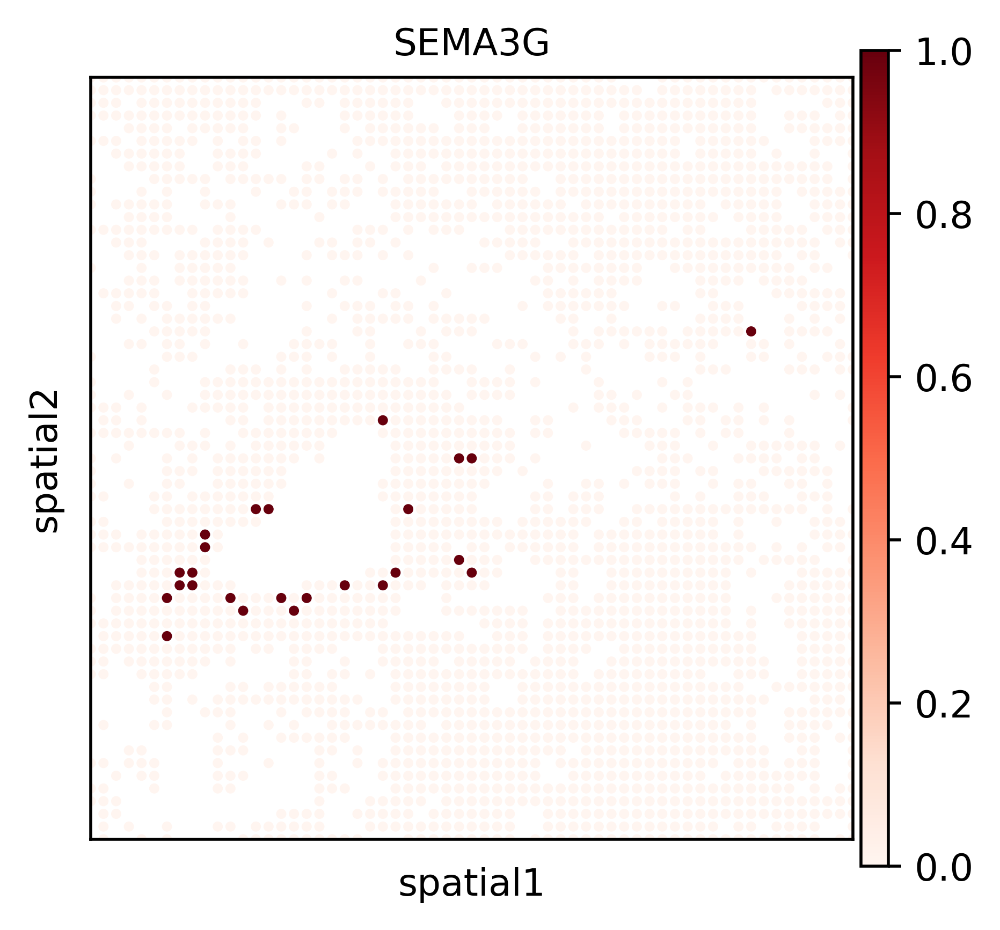

In [20]:
sc.pl.spatial(adata,
              color="SEMA3G",img_key=None,size=8, alpha_img = 0.2, cmap = 'Reds', vmax = 1, crop_coord = [24750,27750,7000,10000])

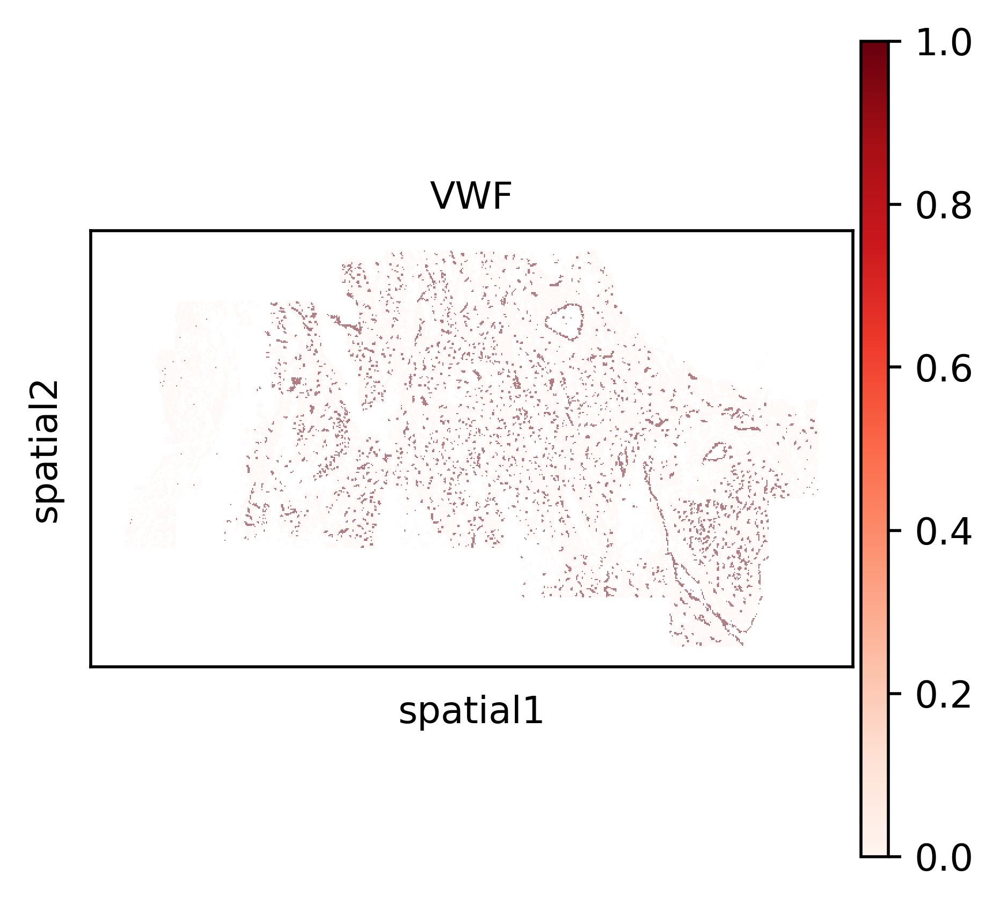

In [9]:
sc.pl.spatial(adata,
              color="VWF",img_key=None,size=8, alpha_img = 0.2, cmap = 'Reds', vmax = 1)

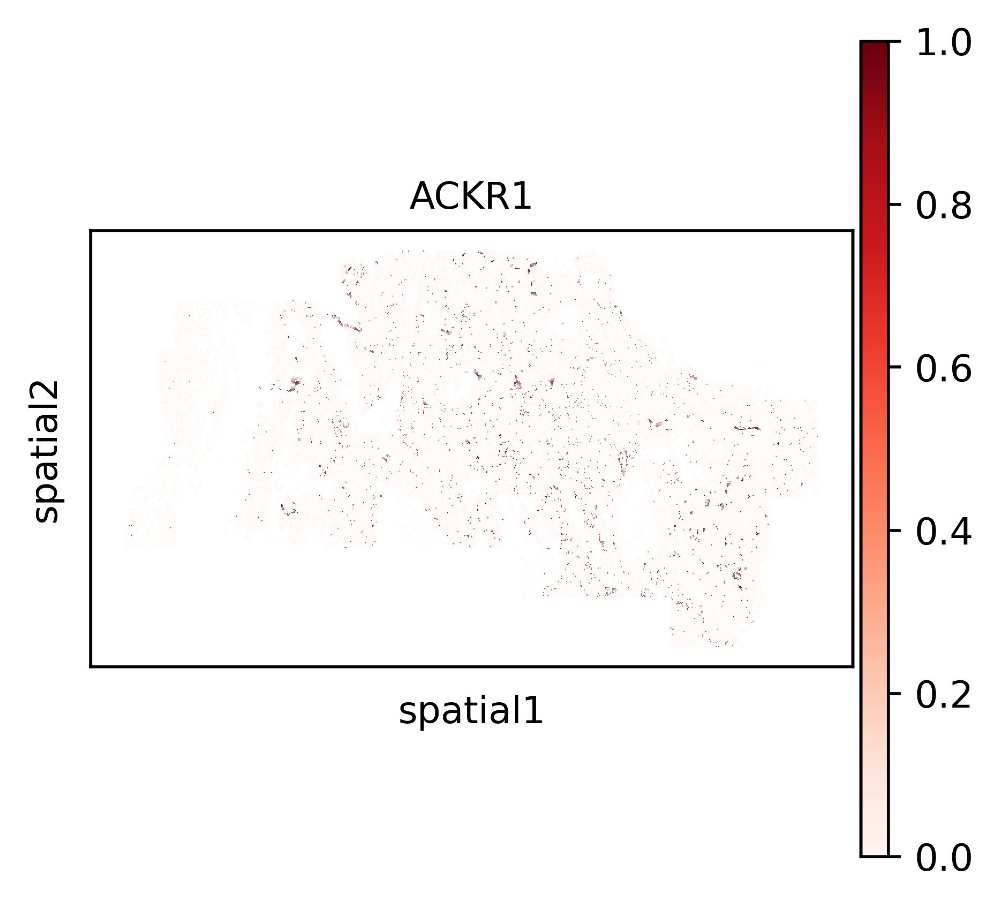

In [8]:
sc.pl.spatial(adata,
              color="ACKR1",img_key=None,size=8, alpha_img = 0.2, cmap = 'Reds', vmax = 1)

In [6]:
adata.obs['arterial_smc'] = (adata.X[:,adata.var_names=='MYH11'] > 1) & (adata.X[:,adata.var_names=='TTN'] == 0)

In [7]:
adata_aec = adata[adata.obs['arterial_smc'] == True]

In [8]:
adata_aec

View of AnnData object with n_obs × n_vars = 3379 × 99
    obs: 'X_Y_bins', 'X_coor', 'Y_coor', 'arterial_smc'
    var: 'Genes'
    uns: 'spatial'
    obsm: 'spatial'

In [9]:
data = adata_aec.obs[['X_coor','Y_coor']]
linkage_data = linkage(data, method='average', metric='euclidean')

In [10]:
temp = dendrogram(linkage_data,no_plot=True)

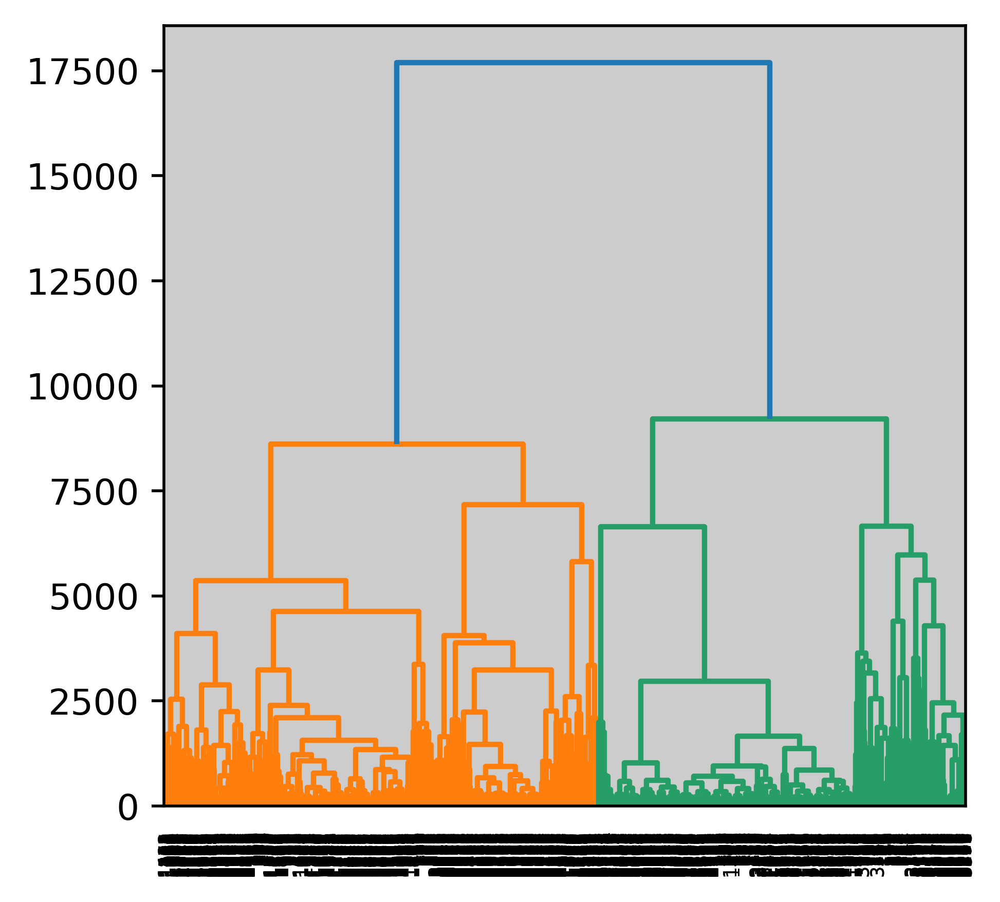

In [11]:
dendrogram(linkage_data)
plt.show()

In [12]:
adata_aec

View of AnnData object with n_obs × n_vars = 3379 × 99
    obs: 'X_Y_bins', 'X_coor', 'Y_coor', 'arterial_smc'
    var: 'Genes'
    uns: 'spatial'
    obsm: 'spatial'

In [13]:
# adjust n_clusters to relevant number of vessels
hierarchical_cluster = AgglomerativeClustering(n_clusters=1000, affinity='euclidean', linkage='single')

In [14]:
labels = hierarchical_cluster.fit_predict(data) 
print(labels)

[124 124 124 ...  23  23 375]


/rds/general/user/snb20/home/anaconda3/envs/scanpy1.8.2/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


In [15]:
adata_aec.obs['SMC_clusters'] = labels
adata_aec.obs['SMC_clusters'] = adata_aec.obs['SMC_clusters'].astype('category')

/var/tmp/pbs.7737892.pbs/ipykernel_64536/1883412233.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_aec.obs['SMC_clusters'] = labels
/rds/general/user/snb20/home/anaconda3/envs/scanpy1.8.2/lib/python3.10/contextlib.py:142: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  next(self.gen)


In [16]:
adata_aec.obs['SMC_clusters'].value_counts()

217    468
25     340
444    319
35     289
24     129
      ... 
468      1
469      1
470      1
471      1
999      1
Name: SMC_clusters, Length: 1000, dtype: int64

In [17]:
#sc.pl.spatial(adata_aec, color="SMC_clusters",img_key='WGA',size=8, alpha_img = 0.2)

In [18]:
# subset for clusters > 5 bins
adata_aec.obs['SMC_clusters'].value_counts()[adata_aec.obs['SMC_clusters'].value_counts() > 5].index.tolist()

[217,
 25,
 444,
 35,
 24,
 221,
 124,
 20,
 205,
 1,
 22,
 10,
 27,
 93,
 39,
 222,
 290,
 48,
 42,
 16,
 4,
 13,
 50,
 117,
 80,
 111,
 6,
 21,
 110,
 446,
 7,
 69,
 34,
 32,
 278,
 138,
 87,
 414,
 158,
 11,
 299,
 3,
 207,
 54,
 59,
 890]

In [19]:
adata_aec_subset = adata_aec[adata_aec.obs.SMC_clusters.isin(adata_aec.obs['SMC_clusters'].value_counts()[adata_aec.obs['SMC_clusters'].value_counts() > 5].index.tolist())]

In [20]:
adata_aec_subset.obs.SMC_clusters = adata_aec_subset.obs.SMC_clusters.astype(str).astype('category')

/rds/general/user/snb20/home/anaconda3/envs/scanpy1.8.2/lib/python3.10/site-packages/pandas/core/generic.py:5931: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  self[name] = value


In [21]:
adata_aec_subset

AnnData object with n_obs × n_vars = 2165 × 99
    obs: 'X_Y_bins', 'X_coor', 'Y_coor', 'arterial_smc', 'SMC_clusters'
    var: 'Genes'
    uns: 'spatial'
    obsm: 'spatial'

In [22]:
#del adata_aec_subset.uns['SMC_clusters_colors']

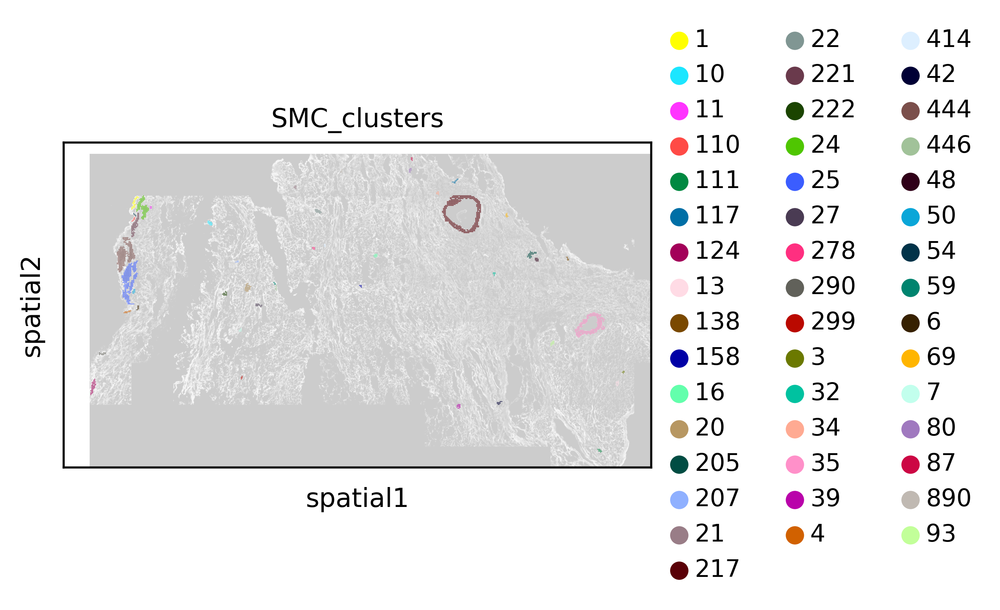

In [23]:
sc.pl.spatial(adata_aec_subset,
              color="SMC_clusters",img_key='WGA',size=8, alpha_img = 0.2)

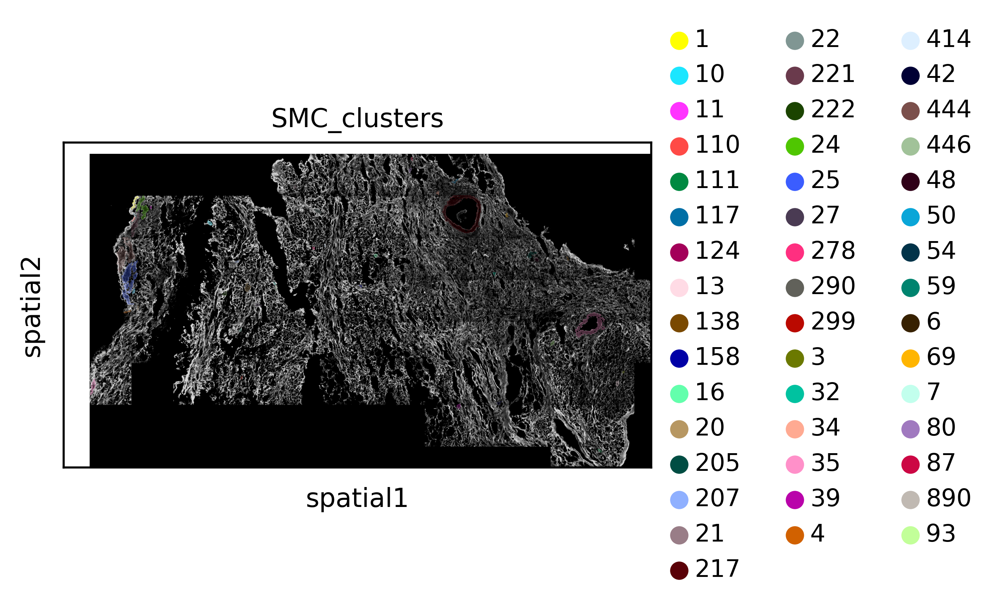

In [24]:
sc.pl.spatial(adata_aec_subset,
              color="SMC_clusters",img_key='WGA',size=6)

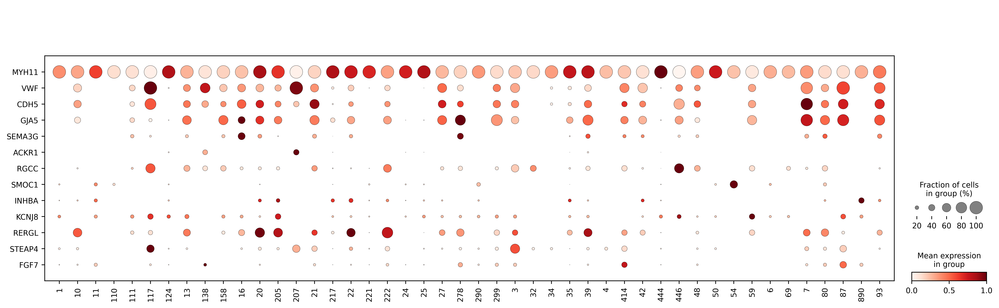

In [25]:
markers = ["MYH11","VWF","CDH5","GJA5","SEMA3G","ACKR1","RGCC","SMOC1","INHBA","KCNJ8","RERGL","STEAP4","FGF7"]
sc.pl.dotplot(adata_aec_subset, markers, "SMC_clusters", cmap = 'Reds', swap_axes = True, standard_scale = 'var')

In [26]:
# add gene percentage expressed to dataframe

In [27]:
adata_aec_subset.obs['RERGL_percent'] = (adata_aec_subset.X[:,adata_aec_subset.var_names=='RERGL'] > 0)

In [28]:
adata_aec_subset.obs['STEAP4_percent'] = (adata_aec_subset.X[:,adata_aec_subset.var_names=='STEAP4'] > 0)

In [29]:
adata_aec_subset.obs['FGF7_percent'] = (adata_aec_subset.X[:,adata_aec_subset.var_names=='FGF7'] > 0)

In [30]:
adata_aec_subset.obs['KCNJ8_percent'] = (adata_aec_subset.X[:,adata_aec_subset.var_names=='KCNJ8'] > 0)

In [31]:
adata_aec_subset.obs['AGT_percent'] = (adata_aec_subset.X[:,adata_aec_subset.var_names=='AGT'] > 0)

In [32]:
adata_aec_subset.obs['STEAP4_FGF7_percent'] = (adata_aec_subset.X[:,adata_aec_subset.var_names=='STEAP4'] > 1) & (adata_aec_subset.X[:,adata_aec_subset.var_names=='FGF7'] > 0)

In [33]:
adata_aec_subset.obs['STEAP4_KCNJ8_percent'] = (adata_aec_subset.X[:,adata_aec_subset.var_names=='STEAP4'] > 1) & (adata_aec_subset.X[:,adata_aec_subset.var_names=='KCNJ8'] > 0)

In [34]:
adata_aec_subset

AnnData object with n_obs × n_vars = 2165 × 99
    obs: 'X_Y_bins', 'X_coor', 'Y_coor', 'arterial_smc', 'SMC_clusters', 'RERGL_percent', 'STEAP4_percent', 'FGF7_percent', 'KCNJ8_percent', 'AGT_percent', 'STEAP4_FGF7_percent', 'STEAP4_KCNJ8_percent'
    var: 'Genes'
    uns: 'spatial', 'SMC_clusters_colors'
    obsm: 'spatial'

In [35]:
results = adata_aec_subset.obs[['RERGL_percent','STEAP4_percent','FGF7_percent','KCNJ8_percent','AGT_percent','STEAP4_FGF7_percent','STEAP4_KCNJ8_percent','SMC_clusters']].groupby('SMC_clusters').mean()

In [36]:
results

,RERGL_percent,STEAP4_percent,FGF7_percent,KCNJ8_percent,AGT_percent,STEAP4_FGF7_percent,STEAP4_KCNJ8_percent
SMC_clusters,,,,,,,
1,0.000000,0.085714,0.028571,0.142857,0.114286,0.000000,0.000000
10,0.611111,0.111111,0.055556,0.000000,0.388889,0.000000,0.000000
11,0.000000,0.000000,0.166667,0.166667,0.166667,0.000000,0.000000
110,0.000000,0.000000,0.000000,0.000000,0.444444,0.000000,0.000000
111,0.181818,0.000000,0.000000,0.181818,0.727273,0.000000,0.000000
117,0.250000,0.500000,0.083333,0.333333,0.500000,0.000000,0.250000
124,0.000000,0.040816,0.020408,0.183673,0.306122,0.000000,0.000000
13,0.461538,0.076923,0.000000,0.230769,0.923077,0.000000,0.000000
138,0.000000,0.000000,0.142857,0.000000,0.428571,0.000000,0.000000


In [37]:
matrix=pd.DataFrame(adata_aec_subset.X,columns=adata_aec_subset.raw.var.index,index=adata_aec_subset.obs.index)

In [38]:
matrix["SMC_clusters"] = adata_aec_subset.obs["SMC_clusters"]

In [39]:
matrix2 = matrix.replace(0, np.NaN)

In [40]:
df_mean_nonzero =matrix2.groupby("SMC_clusters").mean()

In [41]:
df_mean_nonzero[["RERGL","STEAP4","FGF7","AGT","KCNJ8","SEMA3G","ACKR1","RGCC","SMOC1"]]

Genes,RERGL,STEAP4,FGF7,AGT,KCNJ8,SEMA3G,ACKR1,RGCC,SMOC1
SMC_clusters,,,,,,,,,
1,NaN,1.333333,1.0,1.500000,1.400000,NaN,NaN,NaN,2.000000
10,1.818182,1.500000,1.0,2.000000,NaN,NaN,NaN,1.000000,NaN
11,NaN,NaN,1.0,1.000000,1.000000,NaN,NaN,NaN,2.000000
110,NaN,NaN,NaN,2.750000,NaN,NaN,NaN,NaN,1.000000
111,1.500000,NaN,NaN,7.250000,1.000000,1.000000,NaN,5.000000,NaN
117,1.000000,4.666667,1.0,2.500000,1.000000,1.000000,NaN,2.125000,NaN
124,NaN,1.000000,1.0,2.333333,1.555556,NaN,1.0,NaN,2.500000
13,2.000000,1.000000,NaN,6.583333,1.000000,1.000000,NaN,1.800000,NaN
138,NaN,NaN,6.0,1.333333,NaN,NaN,1.0,1.000000,NaN


### add expression values to dataframe

In [42]:
#mean expression (expressing bins only / cluster)
test = pd.concat([results, df_mean_nonzero[["RERGL","STEAP4","FGF7","AGT","KCNJ8","SEMA3G","ACKR1","RGCC","SMOC1"]]], axis = 1)

In [43]:
test

,RERGL_percent,STEAP4_percent,FGF7_percent,KCNJ8_percent,AGT_percent,STEAP4_FGF7_percent,STEAP4_KCNJ8_percent,RERGL,STEAP4,FGF7,AGT,KCNJ8,SEMA3G,ACKR1,RGCC,SMOC1
SMC_clusters,,,,,,,,,,,,,,,,
1,0.000000,0.085714,0.028571,0.142857,0.114286,0.000000,0.000000,NaN,1.333333,1.0,1.500000,1.400000,NaN,NaN,NaN,2.000000
10,0.611111,0.111111,0.055556,0.000000,0.388889,0.000000,0.000000,1.818182,1.500000,1.0,2.000000,NaN,NaN,NaN,1.000000,NaN
11,0.000000,0.000000,0.166667,0.166667,0.166667,0.000000,0.000000,NaN,NaN,1.0,1.000000,1.000000,NaN,NaN,NaN,2.000000
110,0.000000,0.000000,0.000000,0.000000,0.444444,0.000000,0.000000,NaN,NaN,NaN,2.750000,NaN,NaN,NaN,NaN,1.000000
111,0.181818,0.000000,0.000000,0.181818,0.727273,0.000000,0.000000,1.500000,NaN,NaN,7.250000,1.000000,1.000000,NaN,5.000000,NaN
117,0.250000,0.500000,0.083333,0.333333,0.500000,0.000000,0.250000,1.000000,4.666667,1.0,2.500000,1.000000,1.000000,NaN,2.125000,NaN
124,0.000000,0.040816,0.020408,0.183673,0.306122,0.000000,0.000000,NaN,1.000000,1.0,2.333333,1.555556,NaN,1.0,NaN,2.500000
13,0.461538,0.076923,0.000000,0.230769,0.923077,0.000000,0.000000,2.000000,1.000000,NaN,6.583333,1.000000,1.000000,NaN,1.800000,NaN
138,0.000000,0.000000,0.142857,0.000000,0.428571,0.000000,0.000000,NaN,NaN,6.0,1.333333,NaN,NaN,1.0,1.000000,NaN


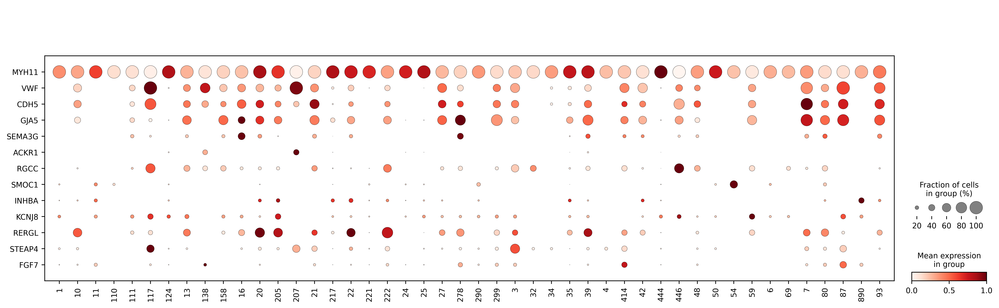

In [44]:
markers = ["MYH11","VWF","CDH5","GJA5","SEMA3G","ACKR1","RGCC","SMOC1","INHBA","KCNJ8","RERGL","STEAP4","FGF7"]
sc.pl.dotplot(adata_aec_subset, markers, "SMC_clusters", cmap = 'Reds', swap_axes = True, standard_scale = 'var')

In [45]:
#add vessel type annotation column

In [46]:
test["Vessel"] = ['Subendocardium','Artery','Subendocardium','Subendocardium','Unclear','Unclear','Subendocardium','Artery','Vein','Artery','Artery','Artery','Artery','Vein','Artery','Artery','Artery','Subendocardium','Artery','Subendocardium','Subendocardium','Artery','Artery','Subendocardium','Artery','Artery','Unclear','Unclear','Artery','Artery','Subendocardium','Artery','Artery','Subendocardium','Unclear','Unclear','Subendocardium','Subendocardium','Artery','Subendocardium','Unclear','Artery','Artery','Artery','Unclear','Artery']

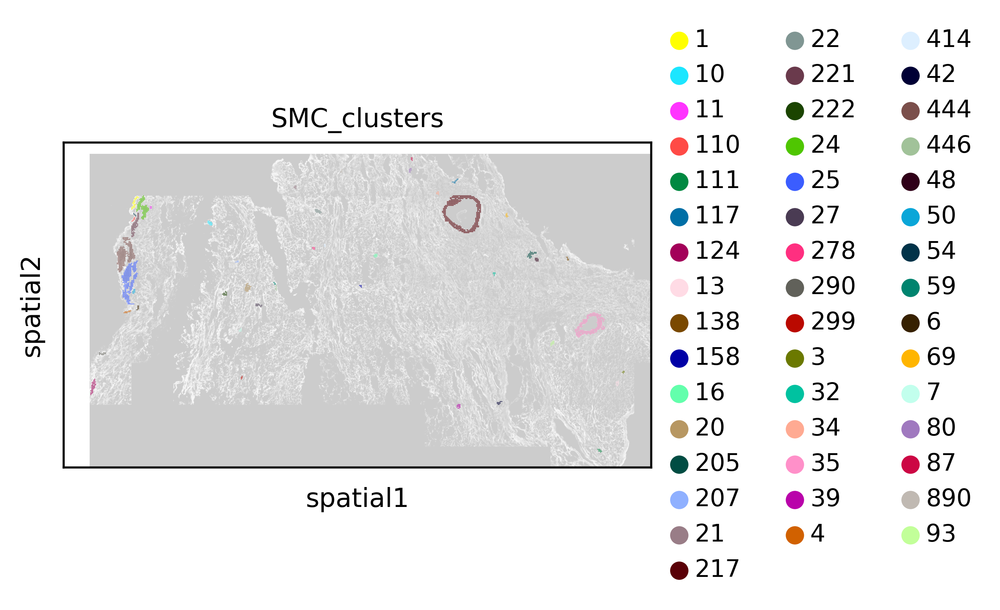

In [47]:
sc.pl.spatial(adata_aec_subset,
              color="SMC_clusters",img_key='WGA',size=8, alpha_img = 0.2)

In [48]:
test

,RERGL_percent,STEAP4_percent,FGF7_percent,KCNJ8_percent,AGT_percent,STEAP4_FGF7_percent,STEAP4_KCNJ8_percent,RERGL,STEAP4,FGF7,AGT,KCNJ8,SEMA3G,ACKR1,RGCC,SMOC1,Vessel
SMC_clusters,,,,,,,,,,,,,,,,,
1,0.000000,0.085714,0.028571,0.142857,0.114286,0.000000,0.000000,NaN,1.333333,1.0,1.500000,1.400000,NaN,NaN,NaN,2.000000,Subendocardium
10,0.611111,0.111111,0.055556,0.000000,0.388889,0.000000,0.000000,1.818182,1.500000,1.0,2.000000,NaN,NaN,NaN,1.000000,NaN,Artery
11,0.000000,0.000000,0.166667,0.166667,0.166667,0.000000,0.000000,NaN,NaN,1.0,1.000000,1.000000,NaN,NaN,NaN,2.000000,Subendocardium
110,0.000000,0.000000,0.000000,0.000000,0.444444,0.000000,0.000000,NaN,NaN,NaN,2.750000,NaN,NaN,NaN,NaN,1.000000,Subendocardium
111,0.181818,0.000000,0.000000,0.181818,0.727273,0.000000,0.000000,1.500000,NaN,NaN,7.250000,1.000000,1.000000,NaN,5.000000,NaN,Unclear
117,0.250000,0.500000,0.083333,0.333333,0.500000,0.000000,0.250000,1.000000,4.666667,1.0,2.500000,1.000000,1.000000,NaN,2.125000,NaN,Unclear
124,0.000000,0.040816,0.020408,0.183673,0.306122,0.000000,0.000000,NaN,1.000000,1.0,2.333333,1.555556,NaN,1.0,NaN,2.500000,Subendocardium
13,0.461538,0.076923,0.000000,0.230769,0.923077,0.000000,0.000000,2.000000,1.000000,NaN,6.583333,1.000000,1.000000,NaN,1.800000,NaN,Artery
138,0.000000,0.000000,0.142857,0.000000,0.428571,0.000000,0.000000,NaN,NaN,6.0,1.333333,NaN,NaN,1.0,1.000000,NaN,Vein


### add vessel size numbers

In [49]:
adata_aec_subset.obs.SMC_clusters.value_counts()

217    468
25     340
444    319
35     289
24     129
221     83
124     49
20      38
1       35
205     35
22      22
10      18
27      17
39      16
93      16
290     15
222     15
48      14
13      13
42      13
4       13
16      13
50      12
117     12
80      12
111     11
6       10
21       9
34       9
110      9
7        9
69       9
446      9
32       8
278      8
87       7
138      7
54       6
59       6
158      6
414      6
207      6
3        6
299      6
890      6
11       6
Name: SMC_clusters, dtype: int64

In [50]:
test2 = test.join(adata_aec_subset.obs['SMC_clusters'].value_counts(), on=None, how='left', lsuffix='', rsuffix='', sort=False, validate=None)

In [51]:
test2.columns = list(test2.columns[0:17]) + ['size']

In [52]:
test2

,RERGL_percent,STEAP4_percent,FGF7_percent,KCNJ8_percent,AGT_percent,STEAP4_FGF7_percent,STEAP4_KCNJ8_percent,RERGL,STEAP4,FGF7,AGT,KCNJ8,SEMA3G,ACKR1,RGCC,SMOC1,Vessel,size
SMC_clusters,,,,,,,,,,,,,,,,,,
1,0.000000,0.085714,0.028571,0.142857,0.114286,0.000000,0.000000,NaN,1.333333,1.0,1.500000,1.400000,NaN,NaN,NaN,2.000000,Subendocardium,35
10,0.611111,0.111111,0.055556,0.000000,0.388889,0.000000,0.000000,1.818182,1.500000,1.0,2.000000,NaN,NaN,NaN,1.000000,NaN,Artery,18
11,0.000000,0.000000,0.166667,0.166667,0.166667,0.000000,0.000000,NaN,NaN,1.0,1.000000,1.000000,NaN,NaN,NaN,2.000000,Subendocardium,6
110,0.000000,0.000000,0.000000,0.000000,0.444444,0.000000,0.000000,NaN,NaN,NaN,2.750000,NaN,NaN,NaN,NaN,1.000000,Subendocardium,9
111,0.181818,0.000000,0.000000,0.181818,0.727273,0.000000,0.000000,1.500000,NaN,NaN,7.250000,1.000000,1.000000,NaN,5.000000,NaN,Unclear,11
117,0.250000,0.500000,0.083333,0.333333,0.500000,0.000000,0.250000,1.000000,4.666667,1.0,2.500000,1.000000,1.000000,NaN,2.125000,NaN,Unclear,12
124,0.000000,0.040816,0.020408,0.183673,0.306122,0.000000,0.000000,NaN,1.000000,1.0,2.333333,1.555556,NaN,1.0,NaN,2.500000,Subendocardium,49
13,0.461538,0.076923,0.000000,0.230769,0.923077,0.000000,0.000000,2.000000,1.000000,NaN,6.583333,1.000000,1.000000,NaN,1.800000,NaN,Artery,13
138,0.000000,0.000000,0.142857,0.000000,0.428571,0.000000,0.000000,NaN,NaN,6.0,1.333333,NaN,NaN,1.0,1.000000,NaN,Vein,7


In [53]:
group=pd.Series("Large", index=test2.index)

In [54]:
group[test2["size"] <= 30] = "Small"

In [55]:
group

SMC_clusters
1      Large
10     Small
11     Small
110    Small
111    Small
117    Small
124    Large
13     Small
138    Small
158    Small
16     Small
20     Large
205    Large
207    Small
21     Small
217    Large
22     Small
221    Large
222    Small
24     Large
25     Large
27     Small
278    Small
290    Small
299    Small
3      Small
32     Small
34     Small
35     Large
39     Small
4      Small
414    Small
42     Small
444    Large
446    Small
48     Small
50     Small
54     Small
59     Small
6      Small
69     Small
7      Small
80     Small
87     Small
890    Small
93     Small
dtype: object

In [56]:
test2["group"] = group

In [57]:
test2

,RERGL_percent,STEAP4_percent,FGF7_percent,KCNJ8_percent,AGT_percent,STEAP4_FGF7_percent,STEAP4_KCNJ8_percent,RERGL,STEAP4,FGF7,AGT,KCNJ8,SEMA3G,ACKR1,RGCC,SMOC1,Vessel,size,group
SMC_clusters,,,,,,,,,,,,,,,,,,,
1,0.000000,0.085714,0.028571,0.142857,0.114286,0.000000,0.000000,NaN,1.333333,1.0,1.500000,1.400000,NaN,NaN,NaN,2.000000,Subendocardium,35,Large
10,0.611111,0.111111,0.055556,0.000000,0.388889,0.000000,0.000000,1.818182,1.500000,1.0,2.000000,NaN,NaN,NaN,1.000000,NaN,Artery,18,Small
11,0.000000,0.000000,0.166667,0.166667,0.166667,0.000000,0.000000,NaN,NaN,1.0,1.000000,1.000000,NaN,NaN,NaN,2.000000,Subendocardium,6,Small
110,0.000000,0.000000,0.000000,0.000000,0.444444,0.000000,0.000000,NaN,NaN,NaN,2.750000,NaN,NaN,NaN,NaN,1.000000,Subendocardium,9,Small
111,0.181818,0.000000,0.000000,0.181818,0.727273,0.000000,0.000000,1.500000,NaN,NaN,7.250000,1.000000,1.000000,NaN,5.000000,NaN,Unclear,11,Small
117,0.250000,0.500000,0.083333,0.333333,0.500000,0.000000,0.250000,1.000000,4.666667,1.0,2.500000,1.000000,1.000000,NaN,2.125000,NaN,Unclear,12,Small
124,0.000000,0.040816,0.020408,0.183673,0.306122,0.000000,0.000000,NaN,1.000000,1.0,2.333333,1.555556,NaN,1.0,NaN,2.500000,Subendocardium,49,Large
13,0.461538,0.076923,0.000000,0.230769,0.923077,0.000000,0.000000,2.000000,1.000000,NaN,6.583333,1.000000,1.000000,NaN,1.800000,NaN,Artery,13,Small
138,0.000000,0.000000,0.142857,0.000000,0.428571,0.000000,0.000000,NaN,NaN,6.0,1.333333,NaN,NaN,1.0,1.000000,NaN,Vein,7,Small


In [58]:
test2["vessel_size"] = test2["Vessel"] + "_" + test2["group"]

In [59]:
test2

,RERGL_percent,STEAP4_percent,FGF7_percent,KCNJ8_percent,AGT_percent,STEAP4_FGF7_percent,STEAP4_KCNJ8_percent,RERGL,STEAP4,FGF7,AGT,KCNJ8,SEMA3G,ACKR1,RGCC,SMOC1,Vessel,size,group,vessel_size
SMC_clusters,,,,,,,,,,,,,,,,,,,,
1,0.000000,0.085714,0.028571,0.142857,0.114286,0.000000,0.000000,NaN,1.333333,1.0,1.500000,1.400000,NaN,NaN,NaN,2.000000,Subendocardium,35,Large,Subendocardium_Large
10,0.611111,0.111111,0.055556,0.000000,0.388889,0.000000,0.000000,1.818182,1.500000,1.0,2.000000,NaN,NaN,NaN,1.000000,NaN,Artery,18,Small,Artery_Small
11,0.000000,0.000000,0.166667,0.166667,0.166667,0.000000,0.000000,NaN,NaN,1.0,1.000000,1.000000,NaN,NaN,NaN,2.000000,Subendocardium,6,Small,Subendocardium_Small
110,0.000000,0.000000,0.000000,0.000000,0.444444,0.000000,0.000000,NaN,NaN,NaN,2.750000,NaN,NaN,NaN,NaN,1.000000,Subendocardium,9,Small,Subendocardium_Small
111,0.181818,0.000000,0.000000,0.181818,0.727273,0.000000,0.000000,1.500000,NaN,NaN,7.250000,1.000000,1.000000,NaN,5.000000,NaN,Unclear,11,Small,Unclear_Small
117,0.250000,0.500000,0.083333,0.333333,0.500000,0.000000,0.250000,1.000000,4.666667,1.0,2.500000,1.000000,1.000000,NaN,2.125000,NaN,Unclear,12,Small,Unclear_Small
124,0.000000,0.040816,0.020408,0.183673,0.306122,0.000000,0.000000,NaN,1.000000,1.0,2.333333,1.555556,NaN,1.0,NaN,2.500000,Subendocardium,49,Large,Subendocardium_Large
13,0.461538,0.076923,0.000000,0.230769,0.923077,0.000000,0.000000,2.000000,1.000000,NaN,6.583333,1.000000,1.000000,NaN,1.800000,NaN,Artery,13,Small,Artery_Small
138,0.000000,0.000000,0.142857,0.000000,0.428571,0.000000,0.000000,NaN,NaN,6.0,1.333333,NaN,NaN,1.0,1.000000,NaN,Vein,7,Small,Vein_Small


In [60]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

### add ROI numbers

In [61]:
test2.index = ['ROI_A2-1_' + str(i) for i in test2.index.tolist()]

In [62]:
test2["ROI"] = "A2-1"

In [63]:
test2

,RERGL_percent,STEAP4_percent,FGF7_percent,KCNJ8_percent,AGT_percent,STEAP4_FGF7_percent,STEAP4_KCNJ8_percent,RERGL,STEAP4,FGF7,AGT,KCNJ8,SEMA3G,ACKR1,RGCC,SMOC1,Vessel,size,group,vessel_size,ROI
ROI_A2-1_1,0.000000,0.085714,0.028571,0.142857,0.114286,0.000000,0.000000,NaN,1.333333,1.0,1.500000,1.400000,NaN,NaN,NaN,2.000000,Subendocardium,35,Large,Subendocardium_Large,A2-1
ROI_A2-1_10,0.611111,0.111111,0.055556,0.000000,0.388889,0.000000,0.000000,1.818182,1.500000,1.0,2.000000,NaN,NaN,NaN,1.000000,NaN,Artery,18,Small,Artery_Small,A2-1
ROI_A2-1_11,0.000000,0.000000,0.166667,0.166667,0.166667,0.000000,0.000000,NaN,NaN,1.0,1.000000,1.000000,NaN,NaN,NaN,2.000000,Subendocardium,6,Small,Subendocardium_Small,A2-1
ROI_A2-1_110,0.000000,0.000000,0.000000,0.000000,0.444444,0.000000,0.000000,NaN,NaN,NaN,2.750000,NaN,NaN,NaN,NaN,1.000000,Subendocardium,9,Small,Subendocardium_Small,A2-1
ROI_A2-1_111,0.181818,0.000000,0.000000,0.181818,0.727273,0.000000,0.000000,1.500000,NaN,NaN,7.250000,1.000000,1.000000,NaN,5.000000,NaN,Unclear,11,Small,Unclear_Small,A2-1
ROI_A2-1_117,0.250000,0.500000,0.083333,0.333333,0.500000,0.000000,0.250000,1.000000,4.666667,1.0,2.500000,1.000000,1.000000,NaN,2.125000,NaN,Unclear,12,Small,Unclear_Small,A2-1
ROI_A2-1_124,0.000000,0.040816,0.020408,0.183673,0.306122,0.000000,0.000000,NaN,1.000000,1.0,2.333333,1.555556,NaN,1.0,NaN,2.500000,Subendocardium,49,Large,Subendocardium_Large,A2-1
ROI_A2-1_13,0.461538,0.076923,0.000000,0.230769,0.923077,0.000000,0.000000,2.000000,1.000000,NaN,6.583333,1.000000,1.000000,NaN,1.800000,NaN,Artery,13,Small,Artery_Small,A2-1
ROI_A2-1_138,0.000000,0.000000,0.142857,0.000000,0.428571,0.000000,0.000000,NaN,NaN,6.0,1.333333,NaN,NaN,1.0,1.000000,NaN,Vein,7,Small,Vein_Small,A2-1
ROI_A2-1_158,0.166667,0.000000,0.000000,0.166667,0.500000,0.000000,0.000000,1.000000,NaN,NaN,3.000000,1.000000,1.000000,NaN,1.500000,NaN,Artery,6,Small,Artery_Small,A2-1


[Text(0.5, 1.0, 'RERGL percentage expression')]

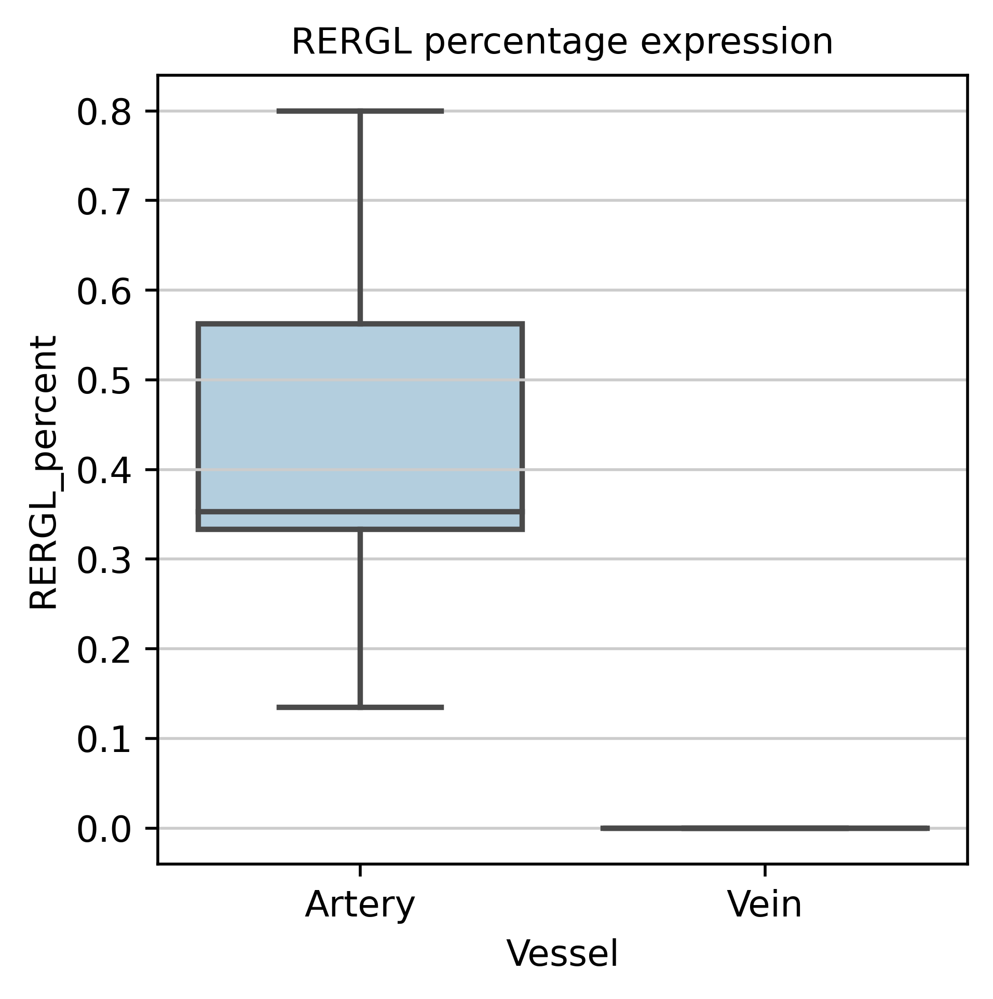

In [83]:
sns.boxplot(data = test2, x = "Vessel", y = "RERGL_percent", palette = 'Blues', order = ['Artery','Vein']).set(title='RERGL percentage expression')

[Text(0.5, 1.0, 'RERGL mean expression')]

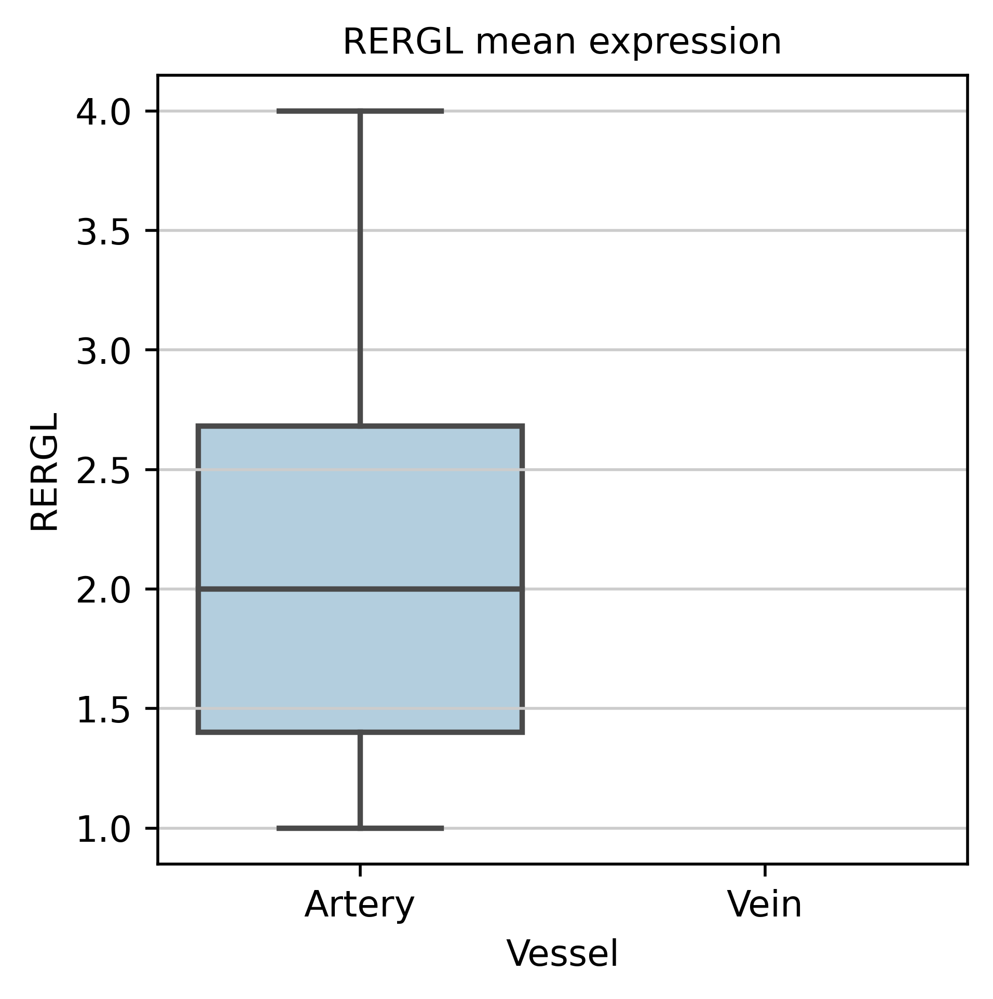

In [84]:
sns.boxplot(data = test2, x = "Vessel", y = "RERGL", palette = 'Blues', order = ['Artery','Vein']).set(title='RERGL mean expression')

[Text(0.5, 1.0, 'STEAP4 percentage expression')]

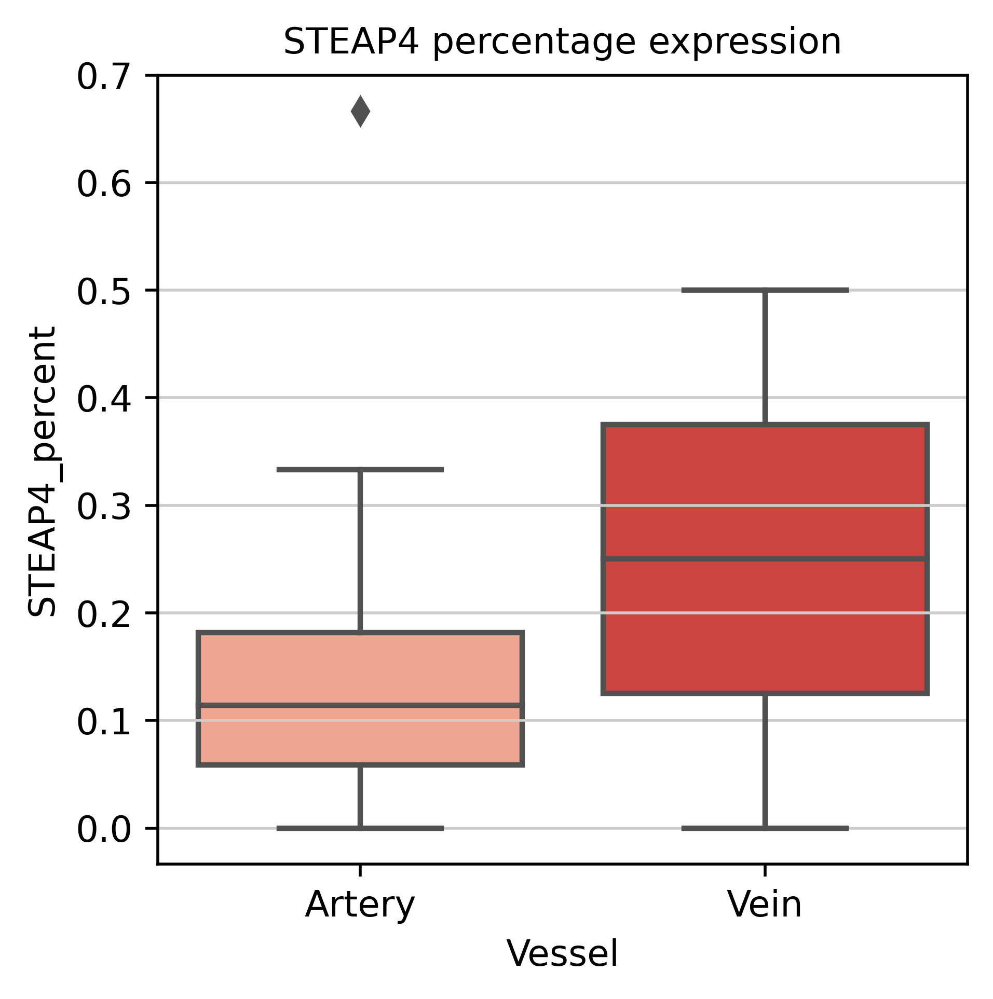

In [85]:
sns.boxplot(data = test, x = "Vessel", y = "STEAP4_percent", palette = 'Reds', order = ['Artery','Vein']).set(title='STEAP4 percentage expression')

[Text(0.5, 1.0, 'STEAP4 mean expression')]

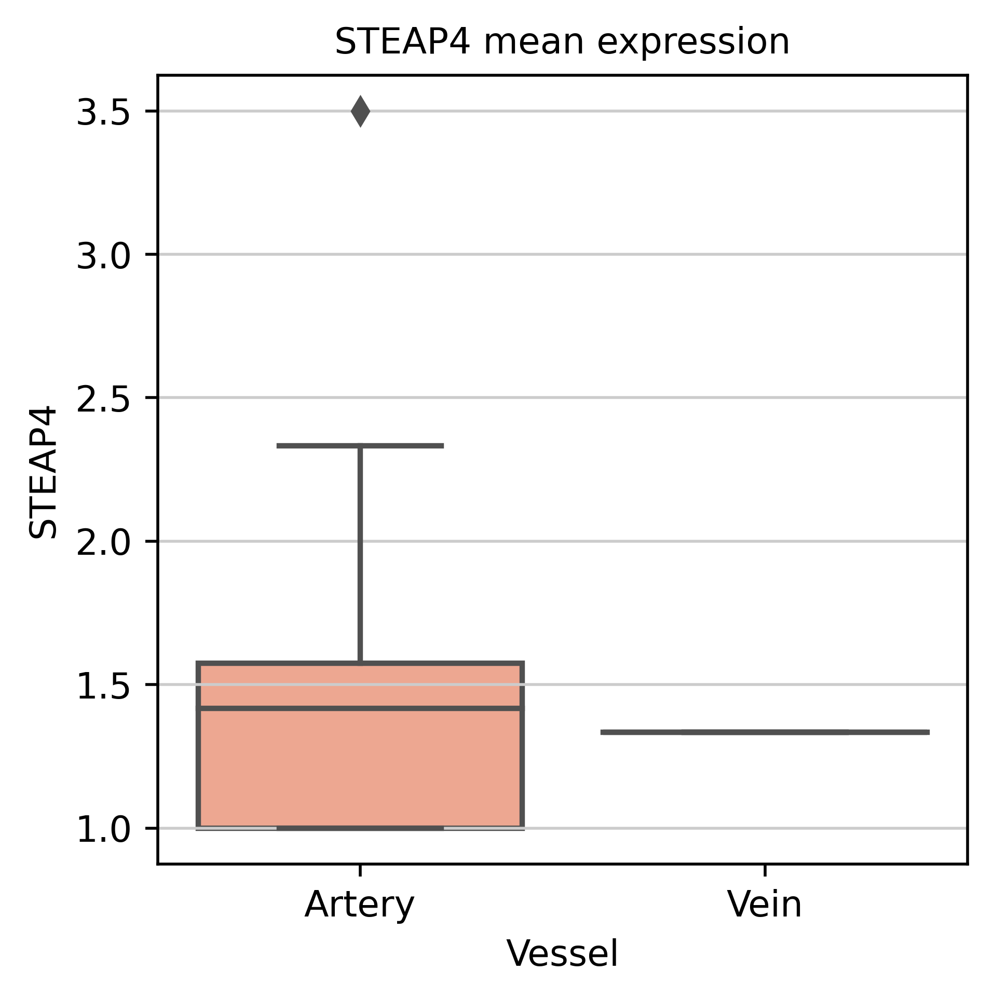

In [86]:
sns.boxplot(data = test, x = "Vessel", y = "STEAP4", palette = 'Reds', order = ['Artery','Vein']).set(title='STEAP4 mean expression')

In [87]:
test2

,RERGL_percent,STEAP4_percent,FGF7_percent,KCNJ8_percent,AGT_percent,STEAP4_FGF7_percent,STEAP4_KCNJ8_percent,RERGL,STEAP4,FGF7,AGT,KCNJ8,SEMA3G,ACKR1,RGCC,SMOC1,Vessel,size,group,vessel_size,ROI
ROI_A2-1_1,0.000000,0.085714,0.028571,0.142857,0.114286,0.000000,0.000000,NaN,1.333333,1.0,1.500000,1.400000,NaN,NaN,NaN,2.000000,Subendocardium,35,Large,Subendocardium_Large,A2-1
ROI_A2-1_10,0.611111,0.111111,0.055556,0.000000,0.388889,0.000000,0.000000,1.818182,1.500000,1.0,2.000000,NaN,NaN,NaN,1.000000,NaN,Artery,18,Small,Artery_Small,A2-1
ROI_A2-1_11,0.000000,0.000000,0.166667,0.166667,0.166667,0.000000,0.000000,NaN,NaN,1.0,1.000000,1.000000,NaN,NaN,NaN,2.000000,Subendocardium,6,Small,Subendocardium_Small,A2-1
ROI_A2-1_110,0.000000,0.000000,0.000000,0.000000,0.444444,0.000000,0.000000,NaN,NaN,NaN,2.750000,NaN,NaN,NaN,NaN,1.000000,Subendocardium,9,Small,Subendocardium_Small,A2-1
ROI_A2-1_111,0.181818,0.000000,0.000000,0.181818,0.727273,0.000000,0.000000,1.500000,NaN,NaN,7.250000,1.000000,1.000000,NaN,5.000000,NaN,Unclear,11,Small,Unclear_Small,A2-1
ROI_A2-1_117,0.250000,0.500000,0.083333,0.333333,0.500000,0.000000,0.250000,1.000000,4.666667,1.0,2.500000,1.000000,1.000000,NaN,2.125000,NaN,Unclear,12,Small,Unclear_Small,A2-1
ROI_A2-1_124,0.000000,0.040816,0.020408,0.183673,0.306122,0.000000,0.000000,NaN,1.000000,1.0,2.333333,1.555556,NaN,1.0,NaN,2.500000,Subendocardium,49,Large,Subendocardium_Large,A2-1
ROI_A2-1_13,0.461538,0.076923,0.000000,0.230769,0.923077,0.000000,0.000000,2.000000,1.000000,NaN,6.583333,1.000000,1.000000,NaN,1.800000,NaN,Artery,13,Small,Artery_Small,A2-1
ROI_A2-1_138,0.000000,0.000000,0.142857,0.000000,0.428571,0.000000,0.000000,NaN,NaN,6.0,1.333333,NaN,NaN,1.0,1.000000,NaN,Vein,7,Small,Vein_Small,A2-1
ROI_A2-1_158,0.166667,0.000000,0.000000,0.166667,0.500000,0.000000,0.000000,1.000000,NaN,NaN,3.000000,1.000000,1.000000,NaN,1.500000,NaN,Artery,6,Small,Artery_Small,A2-1
